In [4]:
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

## Hyperpameters

Define the hyperparameters. You can play with those later.

In [5]:
## Data loading

workers = 4 # Number of workers for dataloader (/!\ set to 4 when you're done debugging)

## Architecture

nz = 100 # Size of z latent vector (i.e. size of generator input)
ndf = 32 # Base size of feature maps in discriminator
ngf = 32 # Base size of feature maps in generator

## Optimization

lrD = 0.0002 # Learning rate for the discriminator
lrG = 0.0002 # Learning rate for the generator
beta1G = 0.5 # Momentum beta1 for the discriminator
beta1D = 0.5 # Momentum beta1 for the generator

## Training

batch_size = 256 # Images per batch
nb_update_D = 1 # Number of sub-steps of discriminator optim. at each step
nb_update_G = 1 # Number of sub-steps of generator optim. at each step
steps = 8000 # Number of global steps in the training loop
nb_epochs = None # Number of epochs, leave "None" if you want to set the number of "steps" (i.e. batches)


if nb_epochs is None:
    nb_epochs = (steps * batch_size) / (nb_update_D * 202000)
else:
    steps = int(nb_epochs * nb_update_D * 202000 / batch_size)
print("Doing %.1f epochs in %d steps" % (nb_epochs, steps))

Doing 10.1 epochs in 8000 steps


# Dataset

Download and load the dataset

In [ ]:
%%sh
# Dataset loading

if ! [ -d "/tmp/celeba/img_align_celeba" ] ; then
    mkdir /tmp/celeba
    cd /tmp/celeba
    wget http://webia.lip6.fr/~douillard/rdfia/celeba.zip
    unzip celeba.zip
fi

# For 64x64 images, replace celeba with celeba64 in the wget and the unzip
# Note that you need to delete previous dataset that is located at /tmp/celeba/img_align_celeba 

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


real batch shape :  torch.Size([256, 3, 32, 32])


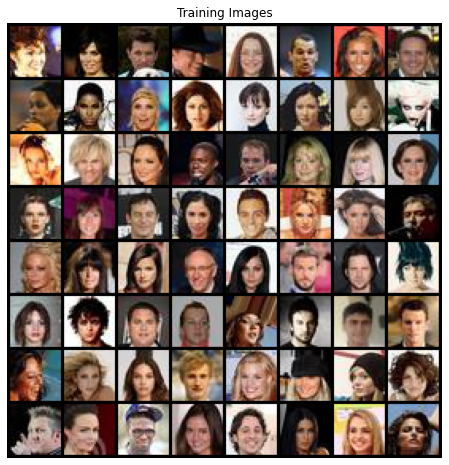

torch.Size([256, 3, 32, 32])


In [20]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root="/tmp/celeba",
                           transform=transforms.Compose([
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers, drop_last=True)

# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")

print("real batch shape : ", real_batch[0].shape)
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()
print(real_batch[0].shape)

In [ ]:
dataset

Dataset ImageFolder
    Number of datapoints: 202599
    Root location: /tmp/celeba
    StandardTransform
Transform: Compose(
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )

# Model architectures

## Discriminator

Input: Image $x \in \mathbb{R}^{32\times 32\times 3}$  
Output: "Real" image probability $\in [0,1]$

* Convolution (`1*ndf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* LeakyReLU ($\alpha = 0.2$)
* Convolution (`2*ndf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* LeakyReLU ($\alpha = 0.2$)
* Convolution (`4*ndf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* LeakyReLU ($\alpha = 0.2$)
* Convolution (1 filter, kernel 4, stride 1, padding 0, no bias)
* Sigmoid activation

## Generator

Input: Random "noise" $z \in \mathbb{R}^{\text{nz}}$  
Output: Generated image $\tilde x \in \mathbb{R}^{32\times 32\times 3}$

* Convolution Transpose (`4*ngf` filters, kernel 4, stride 1, padding 0, no bias)
* Batch Norm 2D
* ReLU
* Convolution Transpose (`2*ngf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* ReLU
* Convolution Transpose (`1*ngf` filters, kernel 4, stride 2, padding 1, no bias)
* Batch Norm 2D
* ReLU
* Convolution Transpose (3 filters, kernel 4, stride 2, padding 1, no bias)
* Tanh activation

In [21]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2),

            nn.Conv2d(ndf, 2*ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(2*ndf),
            nn.LeakyReLU(0.2),

            nn.Conv2d(2*ndf, 4*ndf, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(4*ndf),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(4*ndf, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
                      
        )

    def forward(self, input):
        return self.model(input)



class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d( nz, 4*ngf, kernel_size=4, stride=1, padding=0, bias=False ),
            nn.BatchNorm2d(4*ngf),
            nn.ReLU(),

            nn.ConvTranspose2d(4*ngf, 2*ngf, kernel_size=4, stride=2, padding=1, bias=False ),
            nn.BatchNorm2d(2*ngf),
            nn.ReLU(),

            nn.ConvTranspose2d(2*ngf, ngf, kernel_size=4, stride=2, padding=1, bias=False ),
            nn.BatchNorm2d(ngf),
            nn.ReLU(),

            nn.ConvTranspose2d(ngf, 3, kernel_size=4, stride=2, padding=1, bias=False ),
            nn.Tanh()

        )

    def forward(self, input):
        return self.model(input)
        

In [22]:
# Create the models
netG = Generator().to(device)
netD = Discriminator().to(device)

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
netG.apply(weights_init)
netD.apply(weights_init)

# Print the models
print(netG)
print(netD)

Generator(
  (model): Sequential(
    (0): ConvTranspose2d(100, 128, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)
Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (

# Optimization and training

Here we will define:
* Our prior $P(z)$ that we use to sample random "noise". We will use a Gaussian distribution.
* The criterion that will be used to train the discriminator, and indirectly the generator. We will use the binary cross-entropy.
* The optimizers of both models. We will use the Adam optimizer.

In [ ]:
nz, beta1D, beta1G, lrD, lrG

(100, 0.5, 0.5, 0.0002, 0.0002)

In [23]:
# Prior P(z). Returns a Gaussian random tensor of shape (batch_size, nz, 1, 1)
def get_noise(batch_size):
    noise = torch.randn(batch_size, nz, 1, 1) # TODO
    return noise.to(device)

# Create the criterion function that will take (y_hat, y) as input
criterion = nn.BCELoss() # TODO

# Setup Adam optimizers for D and G
optimizerD = optim.Adam(netD.parameters(), lrD, betas=(beta1D, 0.999)) # TODO, take netD.parameters(), use the right lr and beta1
optimizerG = optim.Adam(netG.parameters(), lrG, betas=(beta1G, 0.999)) # TODO, same for G

### Data format / batch creation functions

In [24]:
# Data format / batch creation functions

fixed_noise = get_noise(196) # Create a fixed random vector sampled from a Gaussian, will be used during train for viz
real_label = 1
fake_label = 0
iterator = iter(dataloader)

# returns a batch of real images from the dataset (iterates infinitely on the dataset)
def get_batch_real():
    global iterator
    try:
        x_real = next(iterator)[0].to(device)
    except:
        iterator = iter(dataloader)
        x_real = next(iterator)[0].to(device)
    y_real = torch.full((x_real.size(0),), real_label, device=device, dtype= torch.float32)
    return x_real, y_real

# returns a batch of generated images and training targets y_fake
# Note that the targets y_fake will be different is train_G is True or False
def get_batch_fake(train_G=False):
    
    z = get_noise(batch_size)
    x_fake = netG(z)  # TODO generate images from 

    if train_G:
      y_fake = torch.full((x_fake.size(0),), real_label, device=device, dtype=torch.float32)
    else:
      y_fake = torch.full((x_fake.size(0),), fake_label, device=device, dtype=torch.float32)

    return x_fake, y_fake

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


### Training Loop

**Reminder:** when your training loop starts to work, change the `workers` variable to 4 and rerun your notebook

In [25]:
def one_epoch_gan_train(netG, netD, dataloader, optimG, optimD, loss, nz=nz, device=device):
    """
        Entraînement pour une epoch
    """

    errorG = 0 # loss de netG
    errorD = 0 # loss de netD
    mean_real_output = 0 # Moyenne des sortie du générateur pour les images réelles
    mean_fake_output = 0 # Moyenne des sortie du générateur pour les images générées
    nb_batch = 0 # nombre de batch

    for real_img in dataloader:

        real_img = real_img[0].to(device) # On récupère les images
        batch_size = real_img.shape[0]

        label_real = torch.ones( size=(batch_size, ), device=real_img.device, dtype=torch.float32)
        label_fake = torch.zeros( size=(batch_size, ), device=real_img.device, dtype=torch.float32)

        


        # Mise à jour du discriminateur netD
        z = torch.randn(batch_size, nz, 1, 1, device=real_img.device, dtype=torch.float32)
        fake_img = netG(z)
        pred_real = netD(real_img).reshape(label_real.shape)
        pred_fake = netD( fake_img.detach() ).reshape(label_fake.shape)

        lossD = loss(pred_real, label_real) + loss(pred_fake, label_fake)
        lossD = lossD / 2

        optimD.zero_grad()
        lossD.backward()
        optimD.step()

        errorD += lossD.detach().item()
        mean_real_output += pred_real.detach().mean().item()
        mean_fake_output += pred_fake.detach().mean().item()

        #optimD.zero_grad()

        # Mise à jour du générateur netG
        z = torch.randn(batch_size, nz, 1, 1, device = real_img.device, dtype=torch.float32)#.to(real_img.device)
        fake_img = netG(z)
        pred_fake = netD(fake_img).reshape(label_fake.shape)

        ### On met à jour le génrateur en faisant croire au discriminateur que les img générer sont réel
        lossG = loss(pred_fake, label_real)
        optimG.zero_grad()
        lossG.backward()
        optimG.step()

        errorG += lossG.detach().item()
        
        nb_batch += 1


    errorD /= nb_batch 
    errorG /= nb_batch
    mean_real_output /= nb_batch
    mean_fake_output /= nb_batch

    return errorD, errorG, mean_real_output, mean_fake_output


import time

def train_gan(netG, netD, dataloader, optimG, optimD, loss, n_epochs=1, nz=nz, device=device, verbose=1, name_dir=None):

    if name_dir is None:
        name_dir = time.asctime()
    
    #os.makedirs("genFaces/"+name_dir, exist_ok=True)
    

    errors_D, errors_G = [], []
    mean_real_out, mean_fake_out = [], []

    for epoch in range(n_epochs):

        errorD, errorG, mean_real_output, mean_fake_output = one_epoch_gan_train(netG, netD,
                                                                                 dataloader, optimG, optimD, loss,
                                                                                 nz, device
                                                                                 )
        errors_D.append(errorD)
        errors_G.append(errorG)
        mean_real_out.append(mean_real_output)
        mean_fake_out.append(mean_fake_output)
        
        if (verbose > 0 and (epoch + 1) % verbose==0 ) or epoch == 0:

            tmp = f"*Epoch {epoch+1}/{n_epochs}\n - D loss : {errorD}\n - G loss  : {errorG}\n" + \
                    f" - D mean real output : {mean_real_output}\n - D mean fake output : {mean_fake_output}"
            print(tmp)

            z = torch.randn(batch_size, nz, 1, 1).to(device)
            with torch.no_grad():
                fake_img = netG(z)
            
            tmp = np.transpose(vutils.make_grid(fake_img.to(device)[:32], padding=1, normalize=True).cpu(), (1,2,0))

            plt.figure(figsize=(15,15))
            plt.axis("off")
            plt.title("Generated Images")
            plt.imshow(tmp)

    

    plt.figure(figsize=(15, 5))
    plt.subplot(121)
    plt.plot(errors_D, label="D loss")
    plt.plot(errors_G, label="G loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.title("Loss")
    plt.legend()

    plt.subplot(122)
    plt.plot(mean_real_out, label="D mean real output")
    plt.plot(mean_fake_out, label="D mean fake output")
    plt.xlabel("Epochs")
    plt.ylabel("mean sigmoid output")
    plt.title("mean sigmoid output")
    plt.legend()

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


*Epoch 1/10
 - D loss : 0.2622207782423187
 - G loss  : 3.488369279127808
 - D mean real output : 0.8103131755112697
 - D mean fake output : 0.19196860696302137
*Epoch 2/10
 - D loss : 0.3916352783834889
 - G loss  : 2.0100247829625038
 - D mean real output : 0.7142188117360194
 - D mean fake output : 0.2803602440897305
*Epoch 3/10
 - D loss : 0.40326122839743206
 - G loss  : 1.8210873070506168
 - D mean real output : 0.7076944227032504
 - D mean fake output : 0.2890211687165438
*Epoch 4/10
 - D loss : 0.3763832565580698
 - G loss  : 1.9323802639349974
 - D mean real output : 0.7275136225066806
 - D mean fake output : 0.26924728300521333
*Epoch 5/10
 - D loss : 0.3522549812433542
 - G loss  : 2.037056194206255
 - D mean real output : 0.7474342588566046
 - D mean fake output : 0.25042464969357103
*Epoch 6/10
 - D loss : 0.3043902321387784
 - G loss  : 2.1969599441993704
 - D mean real output : 0.77669200701486
 - D mean fake output : 0.22184456049731913
*Epoch 7/10
 - D loss : 0.2822109

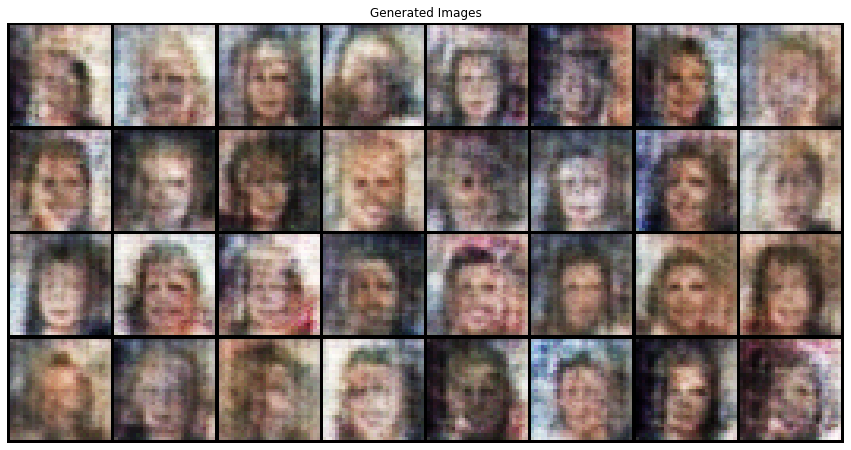

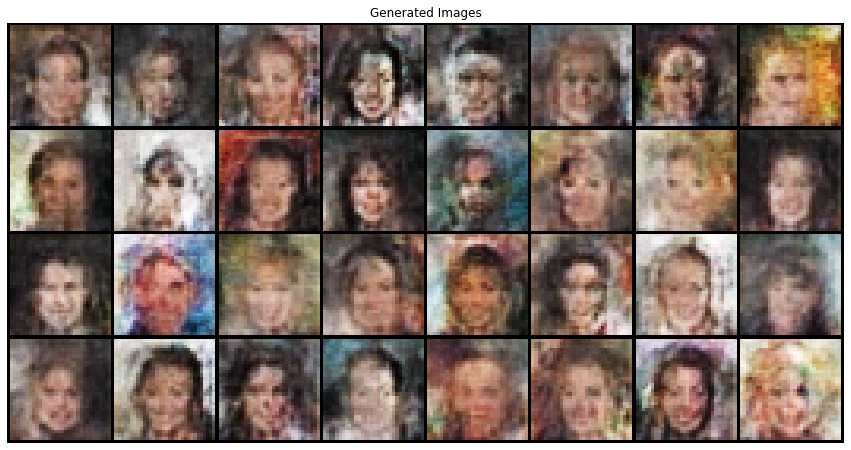

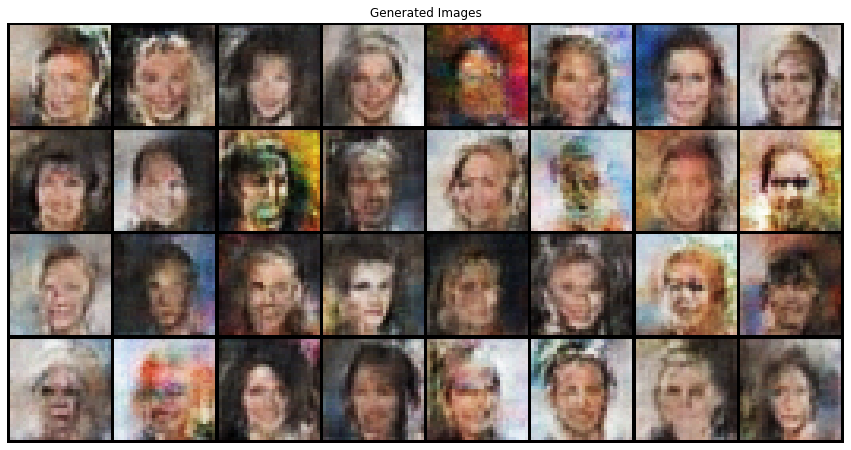

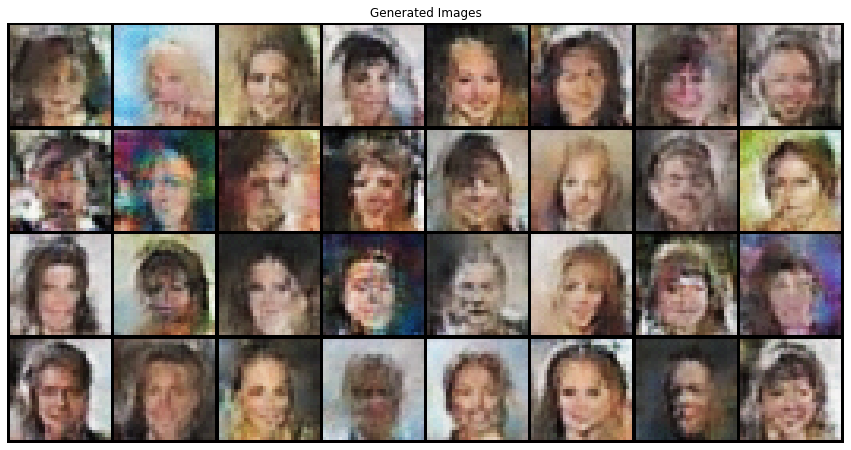

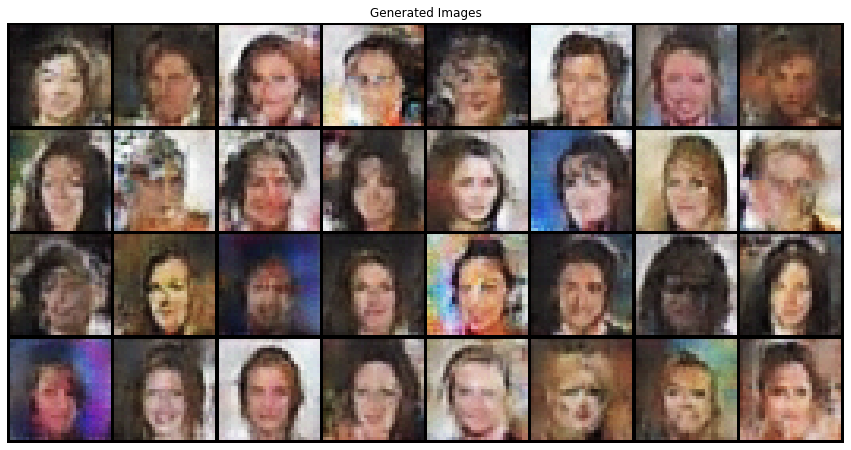

...

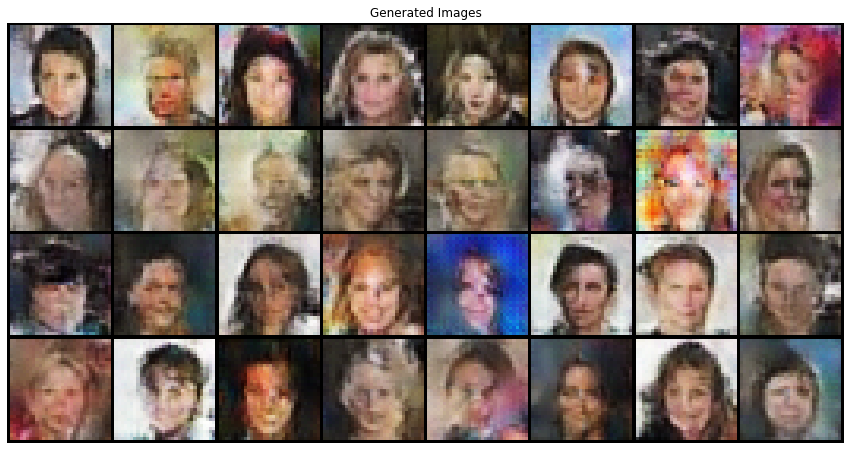

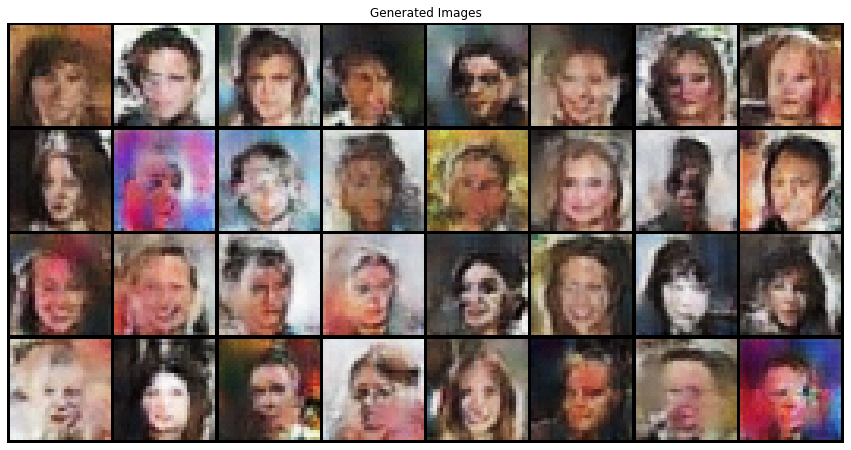

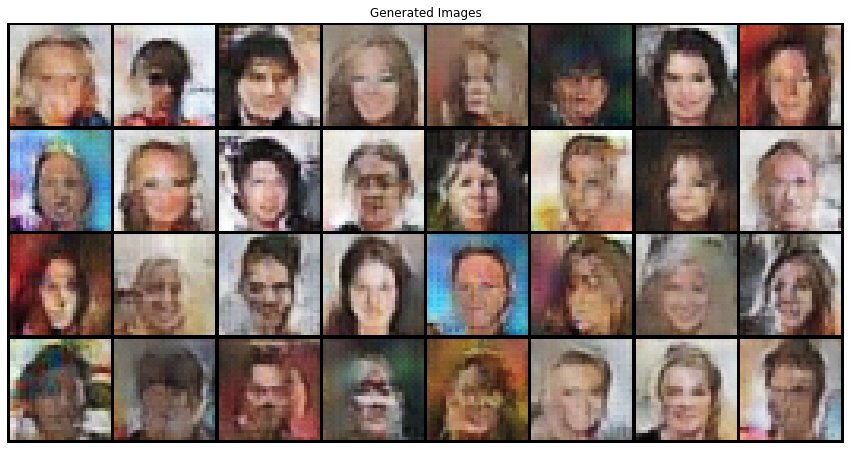

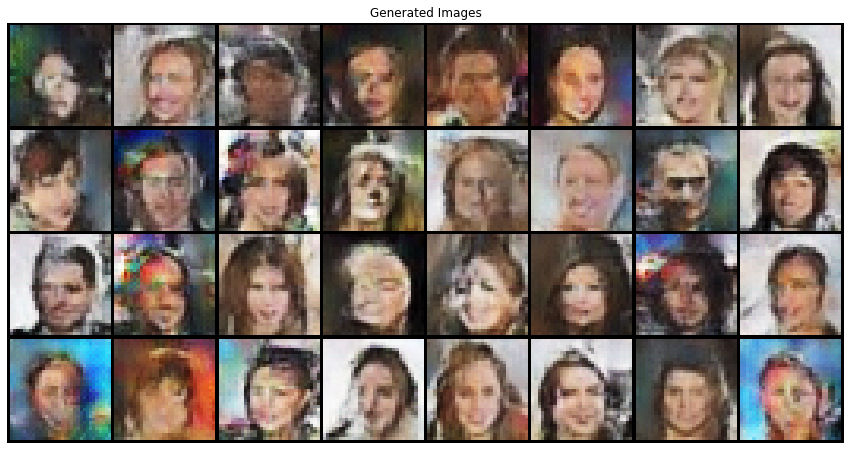

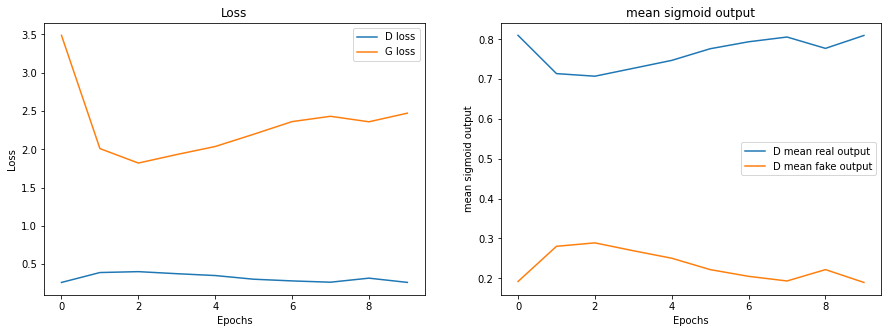

In [26]:
train_gan(netG, netD, dataloader, optimizerG, optimizerD, criterion, n_epochs=10, verbose=1)

In [ ]:
img_list = []
G_losses = []
D_losses = []

In [ ]:
for i in range(steps):
    
    ########
    # Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    for _ in range(nb_update_D):
        netD.zero_grad()
        
        # Create batches
        x_real, y_real = get_batch_real()
        x_fake, y_fake = get_batch_fake()
        
        # Forward 
        y_hat_real = netD(x_real) # TODO
        y_hat_fake = netD(x_fake) # TODO
        errD = criterion(y_hat_fake.squeeze(), y_fake)+ criterion(y_hat_real.squeeze(), y_real)  # TODO sum of criterion of real and fake samples
        
        # backward & optimization step on D
        errD.backward()

        optimizerD.step()
        
        # Compute / save metrics
        avg_output_for_real = y_hat_real.mean().item()
        avg_output_for_fake = y_hat_fake.mean().item()    
        D_losses.append(errD.item())



    ########
    # Update G network: maximize log(D(G(z)))
    for _ in range(nb_update_G):
        netG.zero_grad()
        
        x_fake, y_fake = get_batch_fake(train_G= True)
        
        # TODO: forward + backward
        y_hat_fake = netD(x_fake) 

        # NOTE: use errG as name for your loss variable, like errD above
        errG = criterion(y_hat_fake.squeeze() , y_fake.squeeze() )
        errG.backward()

        optimizerG.step()

        # Compute / save metrics
        G_losses.append(errG.item())
        
    
    ########
    # Logs
    if i % 25 == 0:
        print('[%5d/%5d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
              % (i, steps, errD.item(), errG.item(), avg_output_for_real, avg_output_for_fake))

    if i % 100 == 0:
        with torch.no_grad():
            x_fake = netG(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(x_fake, padding=2, normalize=True, nrow=14))
        plt.figure(figsize=(8,8))
        plt.imshow(np.transpose(img_list[-1],(1,2,0)))
        plt.axis("off")
        plt.show()

# Display training evolution

Animation size has reached 21455094 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


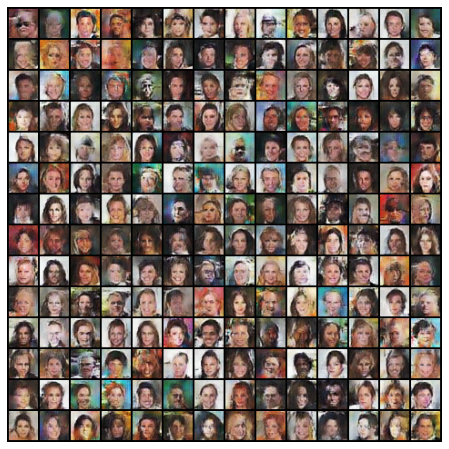

In [ ]:
# Show generations
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

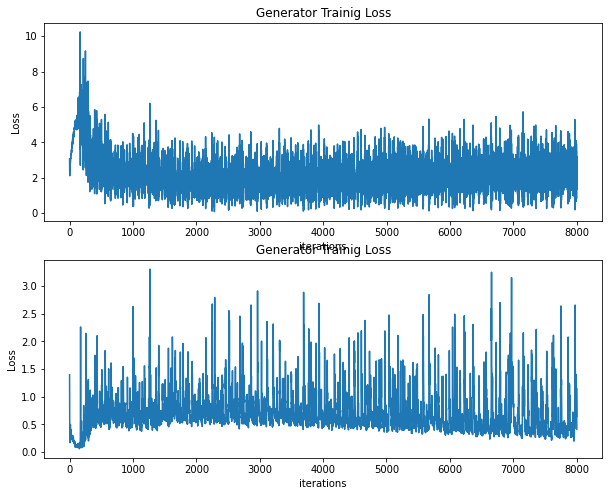

In [ ]:
# Loss evolution
plt.figure(figsize=(10,8))
plt.subplot(2,1,1)
plt.title("Generator Trainig Loss")
plt.plot(G_losses)
plt.xlabel("iterations")
plt.ylabel("Loss")

plt.subplot(2,1,2)
plt.title("Generator Trainig Loss")
plt.plot(D_losses)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.show()

# EXPERIENCES

In [ ]:
## Data loading

workers = 4 # Number of workers for dataloader (/!\ set to 4 when you're done debugging)

## Architecture

nz = 100 # Size of z latent vector (i.e. size of generator input)
ndf = 32 # Base size of feature maps in discriminator
ngf = 32 # Base size of feature maps in generator

## Optimization

lrD = 0.0002 # Learning rate for the discriminator
lrG = 0.0002 # Learning rate for the generator
beta1G = 0.5 # Momentum beta1 for the discriminator
beta1D = 0.5 # Momentum beta1 for the generator

## Training

batch_size = 256 # Images per batch
nb_update_D = 1 # Number of sub-steps of discriminator optim. at each step
nb_update_G = 1 # Number of sub-steps of generator optim. at each step
steps = 8000 # Number of global steps in the training loop
nb_epochs = None # Number of epochs, leave "None" if you want to set the number of "steps" (i.e. batches)


if nb_epochs is None:
    nb_epochs = (steps * batch_size) / (nb_update_D * 202000)
else:
    steps = int(nb_epochs * nb_update_D * 202000 / batch_size)
print("Doing %.1f epochs in %d steps" % (nb_epochs, steps))

In [ ]:
def train_gan():
    # Create the models
    netG = Generator().to(device)
    netD = Discriminator().to(device)
    netG.apply(weights_init)
    netD.apply(weights_init)

    # Print the models
    print(netG)
    print(netD)


    # Setup Adam optimizers for D and G
    optimizerD = optim.Adam(netD.parameters(), lrD, betas=(beta1D, 0.999)) # TODO, take netD.parameters(), use the right lr and beta1
    optimizerG = optim.Adam(netG.parameters(), lrG, betas=(beta1G, 0.999)) # TODO, same for G

    img_list = []
    G_losses = []
    D_losses = []

    for i in range(steps):
    
        ########
        # Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        for _ in range(nb_update_D):
            netD.zero_grad()
            
            # Create batches
            x_real, y_real = get_batch_real()
            x_fake, y_fake = get_batch_fake()
            
            # Forward 
            y_hat_real = netD(x_real) # TODO
            y_hat_fake = netD(x_fake) # TODO
            errD = criterion(y_hat_fake.squeeze(), y_fake)+ criterion(y_hat_real.squeeze(), y_real)  # TODO sum of criterion of real and fake samples
            
            # Backward & optimization step on D
            errD.backward()

            optimizerD.step()
            
            # Compute / save metrics
            avg_output_for_real = y_hat_real.mean().item()
            avg_output_for_fake = y_hat_fake.mean().item()    
            D_losses.append(errD.item())



        ########
        # Update G network: maximize log(D(G(z)))
        for _ in range(nb_update_G):
            netG.zero_grad()
            
            x_fake, y_fake = get_batch_fake(train_G= True)
            
            # TODO: forward + backward
            y_hat_fake = netD(x_fake) 

            # NOTE: use errG as name for your loss variable, like errD above
            errG = criterion(y_hat_fake.squeeze() , y_fake.squeeze() )
            errG.backward()

            optimizerG.step()

            # Compute / save metrics
            G_losses.append(errG.item())
            
        
        ########
        # Logs
        if i % 25 == 0:
            print('[%5d/%5d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
                % (i, steps, errD.item(), errG.item(), avg_output_for_real, avg_output_for_fake))

        if i % 100 == 0:
            with torch.no_grad():
                x_fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(x_fake, padding=2, normalize=True, nrow=14))
            plt.figure(figsize=(8,8))
            plt.imshow(np.transpose(img_list[-1],(1,2,0)))
            plt.axis("off")
            plt.show()

    # Loss evolution
    plt.figure(figsize=(10,8))
    plt.subplot(2,1,1)
    plt.title("Generator Trainig Loss")
    plt.plot(G_losses)
    plt.xlabel("iterations")
    plt.ylabel("Loss")

    plt.subplot(2,1,2)
    plt.title("Generator Trainig Loss")
    plt.plot(D_losses)
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.show()

    return img_list, G_losses, D_losses

### Expérience avec le momentum

Puisqu'on est dans une situation de compétition entre le générateur et le discriminateur, il faut adapter rapidement le gradient (faire un lissage moin fort) s'adapter rapidement

In [ ]:
###  MOMENTUM DE 0.5 A 0.9 (Valeur par défaut)

beta1G = 0.9
beta1D = 0.9

In [ ]:
# Create the models
netG = Generator().to(device)
netD = Discriminator().to(device)
netG.apply(weights_init)
netD.apply(weights_init)

# Print the models
print(netG)
print(netD)


# Setup Adam optimizers for D and G
optimizerD = optim.Adam(netD.parameters(), lrD, betas=(beta1D, 0.999)) # TODO, take netD.parameters(), use the right lr and beta1
optimizerG = optim.Adam(netG.parameters(), lrG, betas=(beta1G, 0.999)) # TODO, same for G

Generator(
  (model): Sequential(
    (0): ConvTranspose2d(100, 128, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)
Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (

### Vanilla gan : utilisation de la "vraie" loss

In [ ]:
beta1G = 0.5
beta1D = 0.5


# Create the models
netG = Generator().to(device)
netD = Discriminator().to(device)
netG.apply(weights_init)
netD.apply(weights_init)

# Print the models
print(netG)
print(netD)


# Setup Adam optimizers for D and G
optimizerD = optim.Adam(netD.parameters(), lrD, betas=(beta1D, 0.999)) # TODO, take netD.parameters(), use the right lr and beta1
optimizerG = optim.Adam(netG.parameters(), lrG, betas=(beta1G, 0.999)) # TODO, same for G

Generator(
  (model): Sequential(
    (0): ConvTranspose2d(100, 128, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)
Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (

In [ ]:
img_list = []
G_losses = []
D_losses = []

for i in range(steps):

    ########
    # Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    for _ in range(nb_update_D):
        netD.zero_grad()
        
        # Create batches
        x_real, y_real = get_batch_real()
        x_fake, y_fake = get_batch_fake()
        
        # Forward 
        y_hat_real = netD(x_real) # TODO
        y_hat_fake = netD(x_fake) # TODO
        errD = criterion(y_hat_fake.squeeze(), y_fake)+ criterion(y_hat_real.squeeze(), y_real)  # TODO sum of criterion of real and fake samples
        
        # Backward & optimization step on D
        errD.backward()

        optimizerD.step()
        
        # Compute / save metrics
        avg_output_for_real = y_hat_real.mean().item()
        avg_output_for_fake = y_hat_fake.mean().item()    
        D_losses.append(errD.item())



    ########
    # Update G network: maximize log(D(G(z)))
    for _ in range(nb_update_G):
        netG.zero_grad()
        
        x_fake, y_fake = get_batch_fake(train_G= False)
        
        # TODO: forward + backward
        y_hat_fake = netD(x_fake) 

        # NOTE: use errG as name for your loss variable, like errD above
        errG = - criterion(y_hat_fake.squeeze() , y_fake.squeeze() )
        errG.backward()

        optimizerG.step()

        # Compute / save metrics
        G_losses.append(errG.item())
        
    
    ########
    # Logs
    if i % 25 == 0:
        print('[%5d/%5d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
            % (i, steps, errD.item(), errG.item(), avg_output_for_real, avg_output_for_fake))

    if i % 100 == 0:
        with torch.no_grad():
            x_fake = netG(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(x_fake, padding=2, normalize=True, nrow=14))
        plt.figure(figsize=(8,8))
        plt.imshow(np.transpose(img_list[-1],(1,2,0)))
        plt.axis("off")
        plt.show()

# Loss evolution
plt.figure(figsize=(10,8))
plt.subplot(2,1,1)
plt.title("Generator Trainig Loss")
plt.plot(G_losses)
plt.xlabel("iterations")
plt.ylabel("Loss")

plt.subplot(2,1,2)
plt.title("Discriminator Trainig Loss")
plt.plot(D_losses)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.show()

### equilibrage

In [ ]:
## Training

batch_size = 256 # Images per batch
nb_update_D = 3 # Number of sub-steps of discriminator optim. at each step
nb_update_G = 1 # Number of sub-steps of generator optim. at each step
steps = 8000 # Number of global steps in the training loop
nb_epochs = None # Number of epochs, leave "None" if you want to set the number of "steps" (i.e. batches)


if nb_epochs is None:
    nb_epochs = (steps * batch_size) / (nb_update_D * 202000)
else:
    steps = int(nb_epochs * nb_update_D * 202000 / batch_size)
print("Doing %.1f epochs in %d steps" % (nb_epochs, steps))

Doing 3.4 epochs in 8000 steps


[    0/ 8000]	Loss_D: 0.5962	Loss_G: 1.7473	D(x): 0.7830	D(G(z)): 0.2792


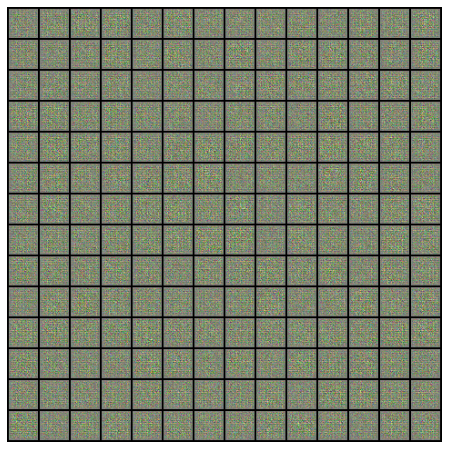

[   25/ 8000]	Loss_D: 0.0363	Loss_G: 5.3289	D(x): 0.9799	D(G(z)): 0.0094
[   50/ 8000]	Loss_D: 0.0086	Loss_G: 6.6528	D(x): 0.9947	D(G(z)): 0.0030
[   75/ 8000]	Loss_D: 0.0052	Loss_G: 8.0957	D(x): 0.9959	D(G(z)): 0.0007
[  100/ 8000]	Loss_D: 0.0037	Loss_G: 7.4611	D(x): 0.9977	D(G(z)): 0.0013


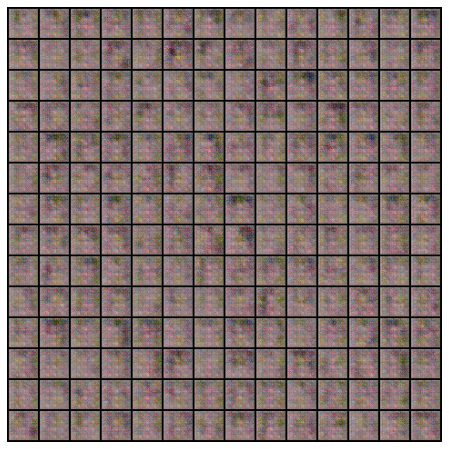

[  125/ 8000]	Loss_D: 0.0049	Loss_G: 9.4288	D(x): 0.9958	D(G(z)): 0.0004
[  150/ 8000]	Loss_D: 0.0093	Loss_G: 6.6282	D(x): 0.9942	D(G(z)): 0.0031
[  175/ 8000]	Loss_D: 0.0549	Loss_G: 8.1641	D(x): 0.9589	D(G(z)): 0.0006
[  200/ 8000]	Loss_D: 0.0451	Loss_G: 5.9021	D(x): 0.9638	D(G(z)): 0.0030


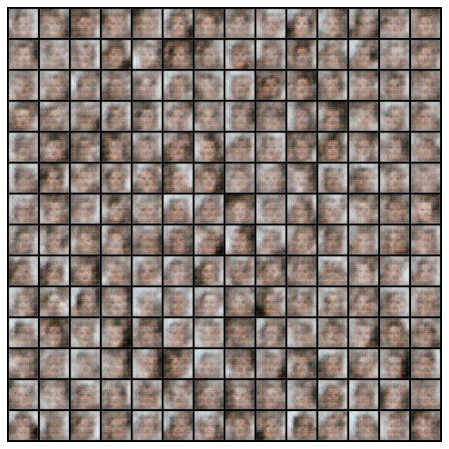

[  225/ 8000]	Loss_D: 0.0649	Loss_G: 6.7238	D(x): 0.9462	D(G(z)): 0.0019
[  250/ 8000]	Loss_D: 0.1131	Loss_G: 5.8758	D(x): 0.9201	D(G(z)): 0.0034
[  275/ 8000]	Loss_D: 0.0491	Loss_G: 5.1583	D(x): 0.9672	D(G(z)): 0.0092
[  300/ 8000]	Loss_D: 0.0666	Loss_G: 5.2786	D(x): 0.9511	D(G(z)): 0.0071


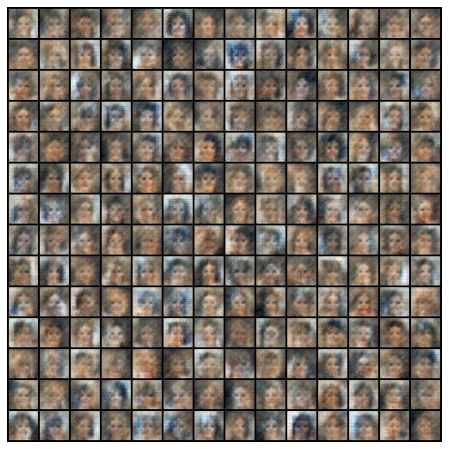

[  325/ 8000]	Loss_D: 0.0549	Loss_G: 3.6805	D(x): 0.9808	D(G(z)): 0.0282
[  350/ 8000]	Loss_D: 0.0753	Loss_G: 5.5674	D(x): 0.9412	D(G(z)): 0.0049
[  375/ 8000]	Loss_D: 0.0713	Loss_G: 5.0677	D(x): 0.9439	D(G(z)): 0.0062
[  400/ 8000]	Loss_D: 0.1205	Loss_G: 4.2152	D(x): 0.9483	D(G(z)): 0.0432


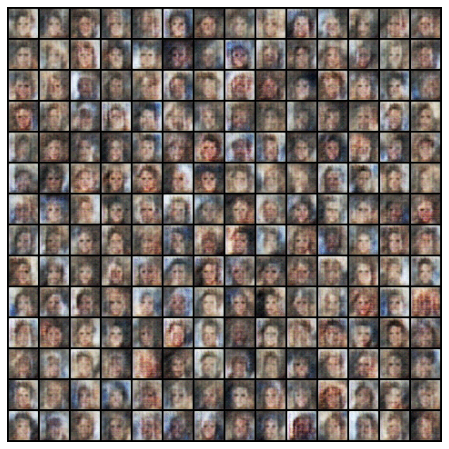

[  425/ 8000]	Loss_D: 0.0626	Loss_G: 4.0414	D(x): 0.9628	D(G(z)): 0.0213
[  450/ 8000]	Loss_D: 0.0767	Loss_G: 4.0424	D(x): 0.9496	D(G(z)): 0.0186
[  475/ 8000]	Loss_D: 0.1041	Loss_G: 4.3858	D(x): 0.9346	D(G(z)): 0.0194
[  500/ 8000]	Loss_D: 0.0857	Loss_G: 4.3789	D(x): 0.9507	D(G(z)): 0.0300


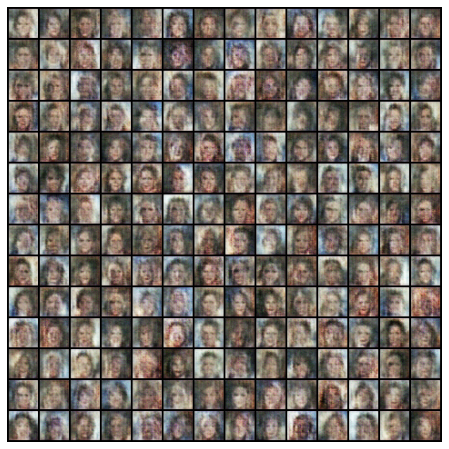

[  525/ 8000]	Loss_D: 0.0787	Loss_G: 4.4408	D(x): 0.9480	D(G(z)): 0.0203
[  550/ 8000]	Loss_D: 0.0751	Loss_G: 4.3073	D(x): 0.9628	D(G(z)): 0.0332
[  575/ 8000]	Loss_D: 0.0575	Loss_G: 4.3583	D(x): 0.9702	D(G(z)): 0.0248
[  600/ 8000]	Loss_D: 0.1781	Loss_G: 2.4731	D(x): 0.9178	D(G(z)): 0.0702


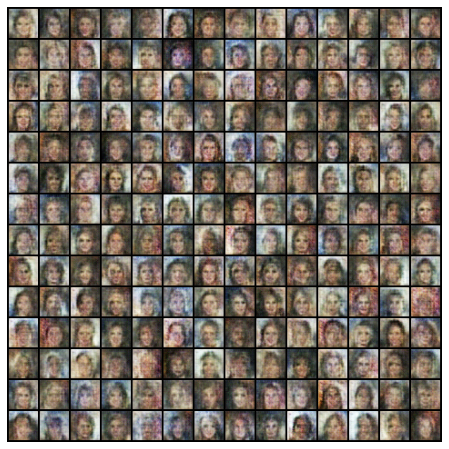

[  625/ 8000]	Loss_D: 0.1333	Loss_G: 4.0623	D(x): 0.9090	D(G(z)): 0.0220
[  650/ 8000]	Loss_D: 0.1478	Loss_G: 3.3591	D(x): 0.9009	D(G(z)): 0.0269
[  675/ 8000]	Loss_D: 0.1006	Loss_G: 4.0450	D(x): 0.9287	D(G(z)): 0.0177
[  700/ 8000]	Loss_D: 0.1038	Loss_G: 3.6606	D(x): 0.9450	D(G(z)): 0.0359


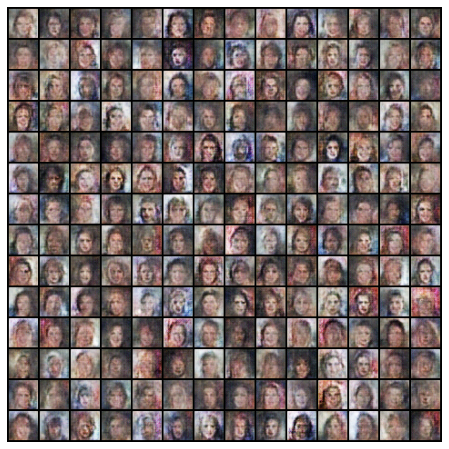

[  725/ 8000]	Loss_D: 0.1287	Loss_G: 4.4438	D(x): 0.9563	D(G(z)): 0.0716
[  750/ 8000]	Loss_D: 0.1709	Loss_G: 3.2169	D(x): 0.9125	D(G(z)): 0.0626
[  775/ 8000]	Loss_D: 0.1516	Loss_G: 3.7137	D(x): 0.8868	D(G(z)): 0.0177
[  800/ 8000]	Loss_D: 0.1564	Loss_G: 5.5917	D(x): 0.9442	D(G(z)): 0.0817


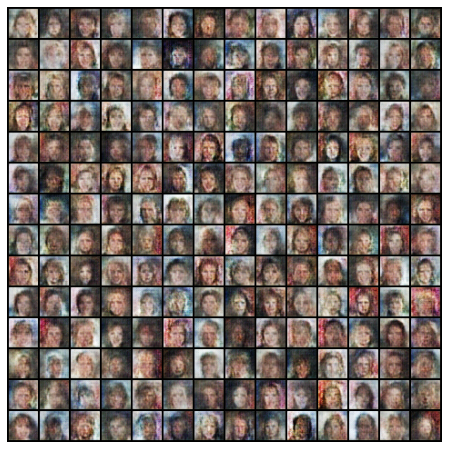

[  825/ 8000]	Loss_D: 4.3809	Loss_G: 1.3589	D(x): 0.0493	D(G(z)): 0.0006
[  850/ 8000]	Loss_D: 0.0981	Loss_G: 3.6851	D(x): 0.9513	D(G(z)): 0.0398
[  875/ 8000]	Loss_D: 0.1069	Loss_G: 4.5175	D(x): 0.9500	D(G(z)): 0.0450
[  900/ 8000]	Loss_D: 0.4493	Loss_G: 2.5343	D(x): 0.9036	D(G(z)): 0.2599


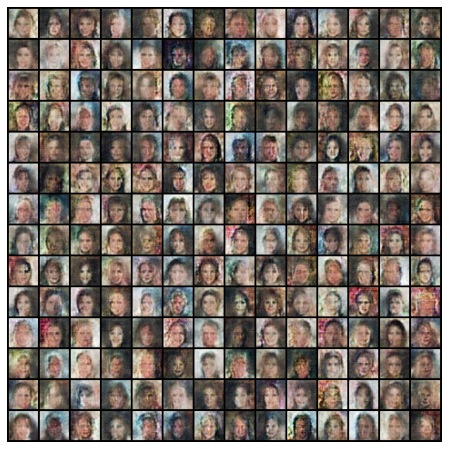

[  925/ 8000]	Loss_D: 0.1964	Loss_G: 3.6979	D(x): 0.8590	D(G(z)): 0.0213
[  950/ 8000]	Loss_D: 0.1058	Loss_G: 3.9034	D(x): 0.9336	D(G(z)): 0.0313
[  975/ 8000]	Loss_D: 0.1141	Loss_G: 3.3700	D(x): 0.9365	D(G(z)): 0.0421
[ 1000/ 8000]	Loss_D: 0.1204	Loss_G: 2.8127	D(x): 0.9455	D(G(z)): 0.0563


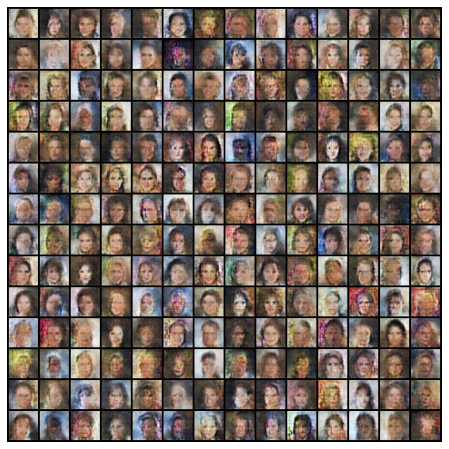

[ 1025/ 8000]	Loss_D: 0.1297	Loss_G: 3.3583	D(x): 0.9354	D(G(z)): 0.0493
[ 1050/ 8000]	Loss_D: 0.1293	Loss_G: 3.2915	D(x): 0.9326	D(G(z)): 0.0478
[ 1075/ 8000]	Loss_D: 0.2125	Loss_G: 2.5476	D(x): 0.8751	D(G(z)): 0.0582
[ 1100/ 8000]	Loss_D: 0.3600	Loss_G: 4.7607	D(x): 0.9392	D(G(z)): 0.2295


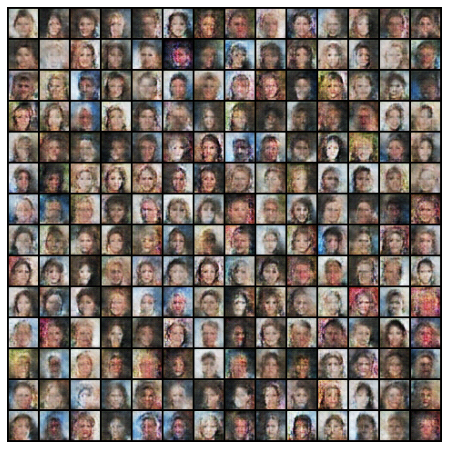

[ 1125/ 8000]	Loss_D: 0.1470	Loss_G: 3.6555	D(x): 0.9371	D(G(z)): 0.0716
[ 1150/ 8000]	Loss_D: 0.4477	Loss_G: 2.5124	D(x): 0.9210	D(G(z)): 0.2718
[ 1175/ 8000]	Loss_D: 0.1896	Loss_G: 2.7935	D(x): 0.8848	D(G(z)): 0.0489
[ 1200/ 8000]	Loss_D: 0.1313	Loss_G: 3.2956	D(x): 0.9383	D(G(z)): 0.0572


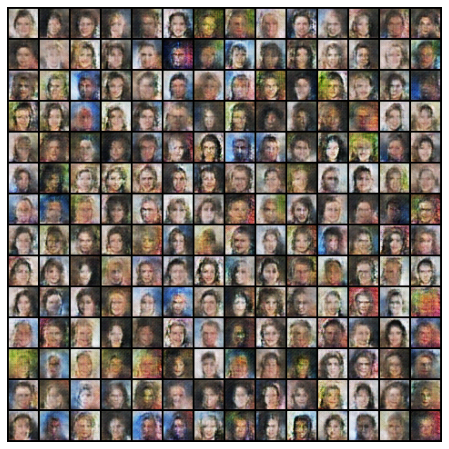

[ 1225/ 8000]	Loss_D: 0.1601	Loss_G: 3.2728	D(x): 0.9483	D(G(z)): 0.0916
[ 1250/ 8000]	Loss_D: 0.1904	Loss_G: 4.0836	D(x): 0.9637	D(G(z)): 0.1276
[ 1275/ 8000]	Loss_D: 0.1028	Loss_G: 4.2452	D(x): 0.9420	D(G(z)): 0.0382
[ 1300/ 8000]	Loss_D: 0.1929	Loss_G: 3.6930	D(x): 0.9389	D(G(z)): 0.1090


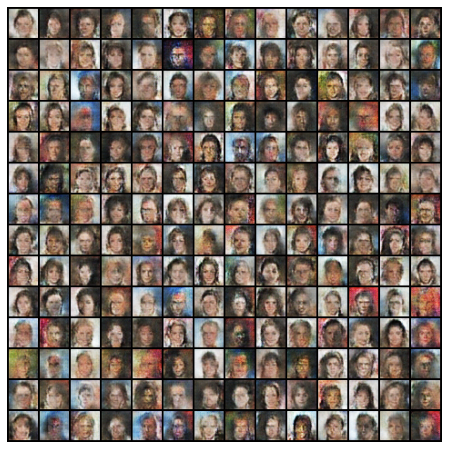

[ 1325/ 8000]	Loss_D: 0.1844	Loss_G: 2.7157	D(x): 0.9112	D(G(z)): 0.0737
[ 1350/ 8000]	Loss_D: 0.1149	Loss_G: 3.5245	D(x): 0.9430	D(G(z)): 0.0490
[ 1375/ 8000]	Loss_D: 0.1171	Loss_G: 3.1984	D(x): 0.9392	D(G(z)): 0.0471
[ 1400/ 8000]	Loss_D: 0.7746	Loss_G: 3.7110	D(x): 0.9667	D(G(z)): 0.4295


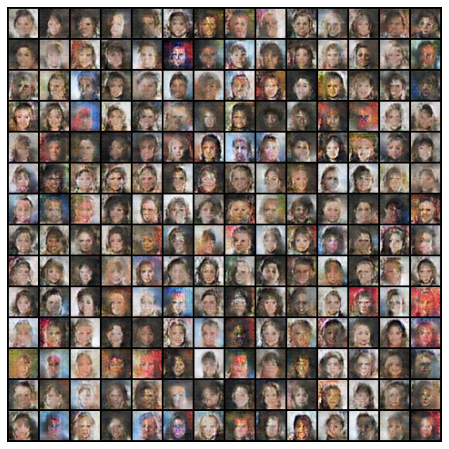

[ 1425/ 8000]	Loss_D: 0.1212	Loss_G: 3.6053	D(x): 0.9343	D(G(z)): 0.0450
[ 1450/ 8000]	Loss_D: 0.1931	Loss_G: 2.7413	D(x): 0.9012	D(G(z)): 0.0690
[ 1475/ 8000]	Loss_D: 0.1060	Loss_G: 3.3859	D(x): 0.9463	D(G(z)): 0.0446
[ 1500/ 8000]	Loss_D: 0.1191	Loss_G: 3.9023	D(x): 0.9177	D(G(z)): 0.0259


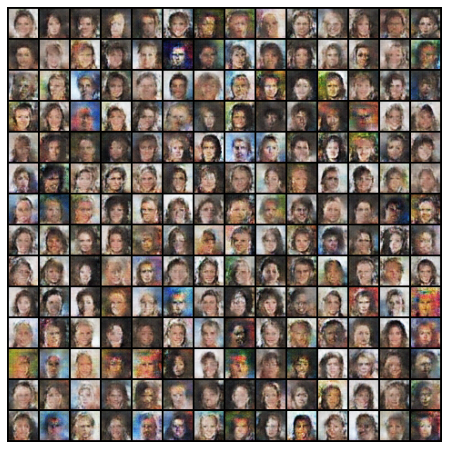

[ 1525/ 8000]	Loss_D: 0.5063	Loss_G: 2.7520	D(x): 0.8560	D(G(z)): 0.2573
[ 1550/ 8000]	Loss_D: 0.1670	Loss_G: 3.0800	D(x): 0.9100	D(G(z)): 0.0573
[ 1575/ 8000]	Loss_D: 0.1661	Loss_G: 2.9548	D(x): 0.9004	D(G(z)): 0.0499
[ 1600/ 8000]	Loss_D: 0.1697	Loss_G: 3.0965	D(x): 0.9006	D(G(z)): 0.0539


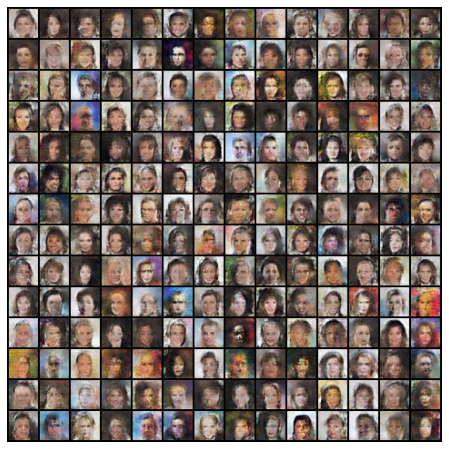

[ 1625/ 8000]	Loss_D: 0.1359	Loss_G: 2.7819	D(x): 0.9345	D(G(z)): 0.0597
[ 1650/ 8000]	Loss_D: 0.1129	Loss_G: 3.4646	D(x): 0.9529	D(G(z)): 0.0587
[ 1675/ 8000]	Loss_D: 0.1322	Loss_G: 3.4193	D(x): 0.9490	D(G(z)): 0.0713
[ 1700/ 8000]	Loss_D: 0.3135	Loss_G: 2.2825	D(x): 0.8852	D(G(z)): 0.1492


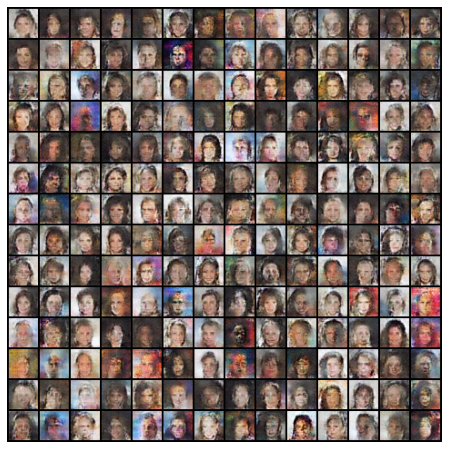

[ 1725/ 8000]	Loss_D: 0.1939	Loss_G: 2.3290	D(x): 0.9165	D(G(z)): 0.0885
[ 1750/ 8000]	Loss_D: 0.1438	Loss_G: 3.1593	D(x): 0.9197	D(G(z)): 0.0487
[ 1775/ 8000]	Loss_D: 0.1697	Loss_G: 3.0962	D(x): 0.8960	D(G(z)): 0.0451
[ 1800/ 8000]	Loss_D: 0.1369	Loss_G: 3.0866	D(x): 0.9334	D(G(z)): 0.0561


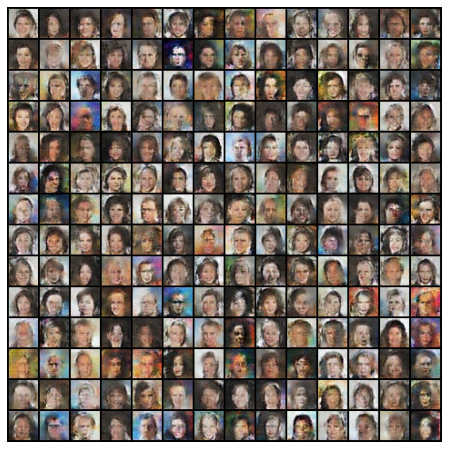

[ 1825/ 8000]	Loss_D: 0.1591	Loss_G: 2.9871	D(x): 0.8968	D(G(z)): 0.0371
[ 1850/ 8000]	Loss_D: 0.3331	Loss_G: 2.8782	D(x): 0.8705	D(G(z)): 0.1545
[ 1875/ 8000]	Loss_D: 0.1189	Loss_G: 3.4219	D(x): 0.9556	D(G(z)): 0.0649
[ 1900/ 8000]	Loss_D: 0.1223	Loss_G: 3.5754	D(x): 0.9517	D(G(z)): 0.0655


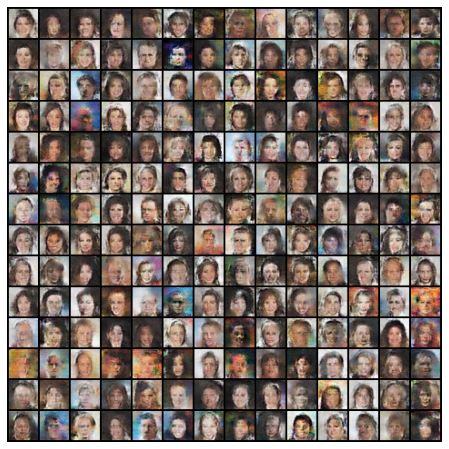

[ 1925/ 8000]	Loss_D: 1.0963	Loss_G: 4.0758	D(x): 0.9865	D(G(z)): 0.6123
[ 1950/ 8000]	Loss_D: 0.1612	Loss_G: 2.3289	D(x): 0.9046	D(G(z)): 0.0494
[ 1975/ 8000]	Loss_D: 0.1270	Loss_G: 3.2948	D(x): 0.9368	D(G(z)): 0.0515
[ 2000/ 8000]	Loss_D: 0.1335	Loss_G: 3.6194	D(x): 0.9390	D(G(z)): 0.0628


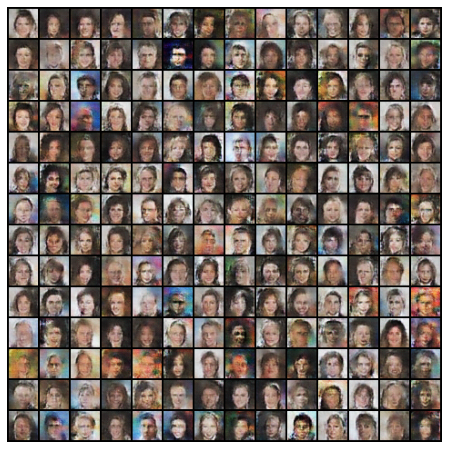

[ 2025/ 8000]	Loss_D: 0.1491	Loss_G: 2.8403	D(x): 0.9119	D(G(z)): 0.0473
[ 2050/ 8000]	Loss_D: 0.3675	Loss_G: 2.7204	D(x): 0.9556	D(G(z)): 0.2487
[ 2075/ 8000]	Loss_D: 0.2896	Loss_G: 2.4958	D(x): 0.8254	D(G(z)): 0.0543
[ 2100/ 8000]	Loss_D: 0.1632	Loss_G: 3.3440	D(x): 0.9140	D(G(z)): 0.0613


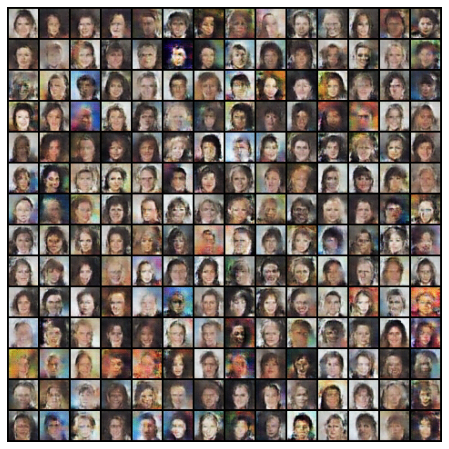

[ 2125/ 8000]	Loss_D: 0.1360	Loss_G: 3.0679	D(x): 0.9331	D(G(z)): 0.0585
[ 2150/ 8000]	Loss_D: 0.1030	Loss_G: 3.5030	D(x): 0.9624	D(G(z)): 0.0589
[ 2175/ 8000]	Loss_D: 0.1806	Loss_G: 2.4558	D(x): 0.8776	D(G(z)): 0.0293
[ 2200/ 8000]	Loss_D: 0.1418	Loss_G: 3.3715	D(x): 0.9321	D(G(z)): 0.0630


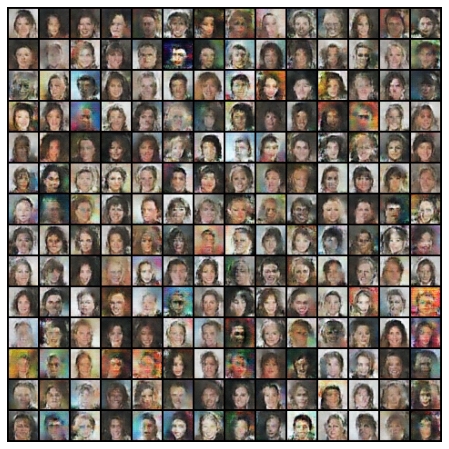

[ 2225/ 8000]	Loss_D: 0.1550	Loss_G: 3.5956	D(x): 0.9542	D(G(z)): 0.0947
[ 2250/ 8000]	Loss_D: 0.1730	Loss_G: 4.0098	D(x): 0.9685	D(G(z)): 0.1198
[ 2275/ 8000]	Loss_D: 0.1683	Loss_G: 3.2009	D(x): 0.9341	D(G(z)): 0.0823
[ 2300/ 8000]	Loss_D: 0.1394	Loss_G: 3.1151	D(x): 0.9426	D(G(z)): 0.0693


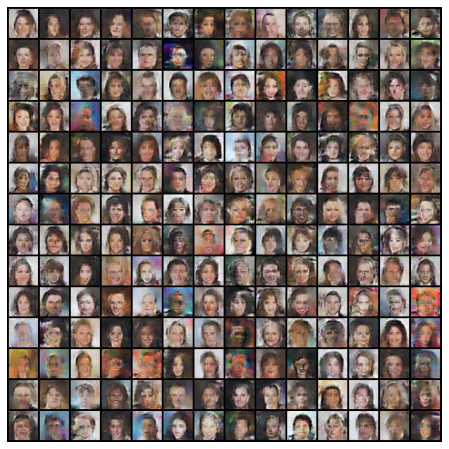

[ 2325/ 8000]	Loss_D: 0.1624	Loss_G: 3.0071	D(x): 0.9216	D(G(z)): 0.0673
[ 2350/ 8000]	Loss_D: 0.3791	Loss_G: 2.7238	D(x): 0.9510	D(G(z)): 0.2552
[ 2375/ 8000]	Loss_D: 0.1542	Loss_G: 3.1400	D(x): 0.9521	D(G(z)): 0.0911
[ 2400/ 8000]	Loss_D: 0.1275	Loss_G: 2.9458	D(x): 0.9146	D(G(z)): 0.0317


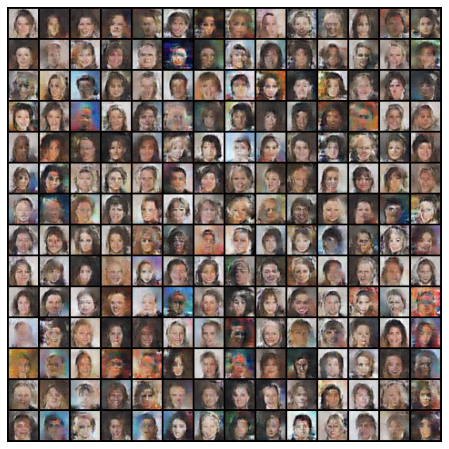

[ 2425/ 8000]	Loss_D: 0.8634	Loss_G: 1.6800	D(x): 0.6910	D(G(z)): 0.3326
[ 2450/ 8000]	Loss_D: 0.3023	Loss_G: 2.5637	D(x): 0.9549	D(G(z)): 0.2045
[ 2475/ 8000]	Loss_D: 0.1554	Loss_G: 2.9752	D(x): 0.8995	D(G(z)): 0.0387
[ 2500/ 8000]	Loss_D: 0.1333	Loss_G: 3.2215	D(x): 0.9375	D(G(z)): 0.0591


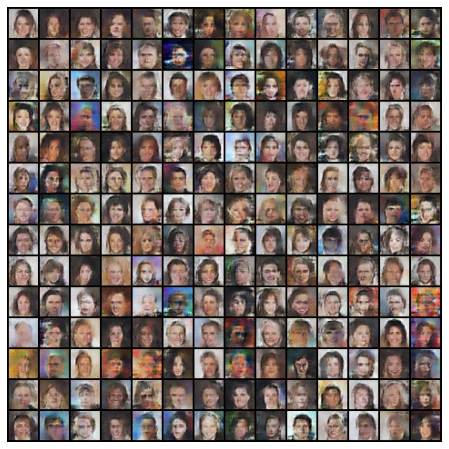

[ 2525/ 8000]	Loss_D: 0.1109	Loss_G: 3.0675	D(x): 0.9566	D(G(z)): 0.0588
[ 2550/ 8000]	Loss_D: 0.0997	Loss_G: 3.1551	D(x): 0.9505	D(G(z)): 0.0418
[ 2575/ 8000]	Loss_D: 0.1226	Loss_G: 3.1355	D(x): 0.9585	D(G(z)): 0.0709
[ 2600/ 8000]	Loss_D: 0.1321	Loss_G: 3.5545	D(x): 0.9459	D(G(z)): 0.0662


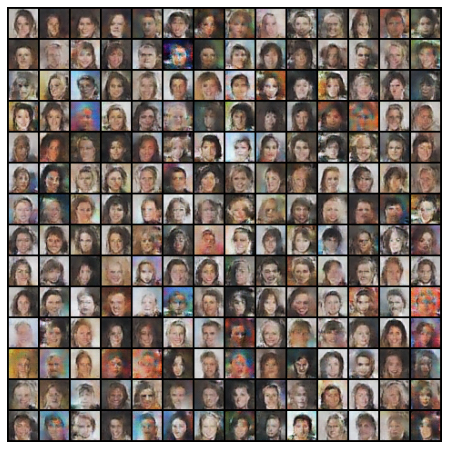

[ 2625/ 8000]	Loss_D: 0.2601	Loss_G: 3.6680	D(x): 0.9535	D(G(z)): 0.1724
[ 2650/ 8000]	Loss_D: 0.2288	Loss_G: 3.6215	D(x): 0.9448	D(G(z)): 0.1410


In [ ]:
_ = train_gan()

In [ ]:
## Training

batch_size = 256 # Images per batch
nb_update_D = 1 # Number of sub-steps of discriminator optim. at each step
nb_update_G = 3 # Number of sub-steps of generator optim. at each step
steps = 8000 # Number of global steps in the training loop
nb_epochs = None # Number of epochs, leave "None" if you want to set the number of "steps" (i.e. batches)


if nb_epochs is None:
    nb_epochs = (steps * batch_size) / (nb_update_D * 202000)
else:
    steps = int(nb_epochs * nb_update_D * 202000 / batch_size)
print("Doing %.1f epochs in %d steps" % (nb_epochs, steps))

In [ ]:
_ = train_gan()

### Learning rate

### $n_z$

In [ ]:
## Architecture

nz = 10 # Size of z latent vector (i.e. size of generator input)


## Training

batch_size = 256 # Images per batch
nb_update_D = 1 # Number of sub-steps of discriminator optim. at each step
nb_update_G = 1 # Number of sub-steps of generator optim. at each step
steps = 8000 # Number of global steps in the training loop
nb_epochs = None # Number of epochs, leave "None" if you want to set the number of "steps" (i.e. batches)


if nb_epochs is None:
    nb_epochs = (steps * batch_size) / (nb_update_D * 202000)
else:
    steps = int(nb_epochs * nb_update_D * 202000 / batch_size)
print("Doing %.1f epochs in %d steps" % (nb_epochs, steps))

In [ ]:
_ = train_gan()

In [ ]:
nz = 1000

In [ ]:
_ = train_gan()

### Mixture in z-space

In [ ]:
nb_z = 5
z1 = get_noise(nb_z)
z2 = get_noise(nb_z)

Z = z1.clone()

alpha_list = torch.arange(0.1, 1.1, 0.1)

for a in alpha_list:
    za = a * z1 + (1 -a) * z2
    Z = pd.concat([Z, za])

In [ ]:
with torch.no_grad():
            x_fake = netG(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(x_fake, padding=2, normalize=True, nrow=14))
        plt.figure(figsize=(8,8))
        plt.imshow(np.transpose(img_list[-1],(1,2,0)))
        plt.axis("off")
        plt.show()